# Start EVA Server

<table align="left">
  <td>
    <a target="_blank" href="https://colab.research.google.com/github/georgia-tech-db/eva/blob/master/tutorials/00-start-eva-server.ipynb"><img src="https://www.tensorflow.org/images/colab_logo_32px.png" /> Run on Google Colab</a>
  </td>
  <td>
    <a target="_blank" href="https://github.com/georgia-tech-db/eva/blob/master/tutorials/00-start-eva-server.ipynb"><img src="https://www.tensorflow.org/images/GitHub-Mark-32px.png" /> View source on GitHub</a>
  </td>
  <td>
    <a target="_blank" href="https://raw.githubusercontent.com/georgia-tech-db/eva/master/tutorials/00-start-eva-server.ipynb"><img src="https://www.tensorflow.org/images/download_logo_32px.png" /> Download notebook</a>
  </td>
</table>

### Launch EVA server

We use this notebook for launching the EVA server.

In [2]:
## Install EVA package if needed
# %pip install "evadb[dev]" --quiet

import os
import time
from psutil import process_iter
from signal import SIGTERM
import re
import itertools

def shell(command):
    print(command)
    os.system(command)

def stop_eva_server():
    for proc in process_iter():
        if proc.name() == "eva_server":
            proc.send_signal(SIGTERM)

def launch_eva_server():
    # Stop EVA server if it is running
    stop_eva_server()

    os.environ['GPU_DEVICES'] = '0'

    # Start EVA server
    shell("nohup eva_server >> eva.log 2>&1 &")

    last_few_lines_count = 3
    try:
        with open('eva.log', 'r') as f:
            for lines in itertools.zip_longest(*[f]*last_few_lines_count):
                print(lines)
    except FileNotFoundError:
        pass

    # Wait for server to start
    time.sleep(10)

def connect_to_server():
    from eva.server.db_api import connect
    %pip install nest_asyncio --quiet
    import nest_asyncio
    nest_asyncio.apply()

    # Connect client with server
    connection = connect(host = '127.0.0.1', port = 5432) 
    cursor = connection.cursor()

    return cursor

# Launch server
launch_eva_server()

nohup eva_server >> eva.log 2>&1 &
("nohup: failed to run command 'eva_server': No such file or directory\n", '04-16-2023 18:25:56 WARNING[create_udf_executor:create_udf_executor.py:exec:0041] UDF FastRCNNObjectDetector already exists, nothing added.\n', '04-16-2023 18:25:56 WARNING[create_udf_executor:create_udf_executor.py:exec:0041] UDF ArrayCount already exists, nothing added.\n')
('04-16-2023 18:25:56 WARNING[create_udf_executor:create_udf_executor.py:exec:0041] UDF Crop already exists, nothing added.\n', '04-16-2023 18:25:56 WARNING[create_udf_executor:create_udf_executor.py:exec:0041] UDF Open already exists, nothing added.\n', '04-16-2023 18:25:56 WARNING[create_udf_executor:create_udf_executor.py:exec:0041] UDF Similarity already exists, nothing added.\n')
('04-16-2023 18:25:56 WARNING[create_udf_executor:create_udf_executor.py:exec:0041] UDF YoloV5 already exists, nothing added.\n', '04-16-2023 18:27:54 ERROR [drop_executor:drop_executor.py:exec:0049] Table: HAPPY does not ex

In [2]:
# !wget -nc https://raw.githubusercontent.com/georgia-tech-db/eva/master/eva/udfs/emotion_detector.py
# !wget -nc https://raw.githubusercontent.com/georgia-tech-db/eva/master/eva/udfs/face_detector.py

In [3]:
cursor = connect_to_server()

Note: you may need to restart the kernel to use updated packages.


In [4]:
# !wget -nc https://www.dropbox.com/s/gzfhwmib7u804zy/defhappy.mp4?raw=1 -O defhappy.mp4

In [4]:
cursor.execute('DROP TABLE MODERN_FAMILY')
response = cursor.fetch_all()
print(response)
cursor.execute('LOAD VIDEO "modern_family.mp4" INTO MODERN_FAMILY')
response = cursor.fetch_all()
print(response)

@status: ResponseStatus.FAIL
@batch: 
 None
@error: Table: MODERN_FAMILY does not exist
@status: ResponseStatus.SUCCESS
@batch: 
                            0
0  Number of loaded VIDEO: 1
@query_time: 0.09879851603182033


In [6]:
# from IPython.display import Video
# Video("modern_family.mp4", height=450, width=800, embed=True)

In [5]:
cursor.execute("""CREATE UDF EmotionDetector 
        INPUT (frame NDARRAY UINT8(ANYDIM, ANYDIM, 3)) 
        OUTPUT (labels NDARRAY STR(ANYDIM), scores NDARRAY FLOAT32(ANYDIM)) 
        TYPE  Classification IMPL 'emotion_detector.py';
        """)
response = cursor.fetch_all()
print(response)

@status: ResponseStatus.SUCCESS
@batch: 
                                                          0
0  UDF EmotionDetector successfully added to the database.
@query_time: 0.26275924895890057


In [6]:
cursor.execute("""CREATE UDF FaceDetector
                  INPUT  (frame NDARRAY UINT8(ANYDIM, ANYDIM, 3))
                  OUTPUT (bboxes NDARRAY FLOAT32(ANYDIM, 4),
                          scores NDARRAY FLOAT32(ANYDIM))
                  TYPE  FaceDetection
                  IMPL  'face_detector.py';
        """)
response = cursor.fetch_all()
print(response)

@status: ResponseStatus.SUCCESS
@batch: 
                                                       0
0  UDF FaceDetector successfully added to the database.
@query_time: 0.04637099499814212


In [10]:
cursor.execute("""SELECT id, FaceDetector(data)
                  FROM MODERN_FAMILY WHERE id=30""")
response = cursor.fetch_all()
response.as_df()

,modern_family.id,facedetector.bboxes,facedetector.scores
0,30,"[[473, 50, 605, 210]]",[0.9999585151672363]


In [11]:
# cursor.execute("""SELECT id, data
#                   FROM MODERN_FAMILY WHERE id=1""")
# response = cursor.fetch_all()
# response.as_df()

In [7]:
cursor.execute("""SELECT id, bbox, EmotionDetector(Crop(data, bbox)) 
                  FROM MODERN_FAMILY JOIN LATERAL  UNNEST(FaceDetector(data)) AS Face(bbox, conf)  
                  WHERE id <= 1800;""")
response = cursor.fetch_all()
response.as_df()

,modern_family.id,Face.bbox,emotiondetector.labels,emotiondetector.scores
0,27,"[499, -17, 627, 141]",happy,0.848217
1,28,"[499, -17, 627, 141]",happy,0.848217
2,29,"[486, 23, 615, 181]",angry,0.902336
3,29,"[246, 66, 356, 184]",neutral,0.554410
4,30,"[473, 50, 605, 210]",sad,0.378213
...,...,...,...,...
2453,1796,"[331, 88, 500, 290]",sad,0.952900
2454,1797,"[349, 97, 512, 294]",sad,0.984088
2455,1798,"[369, 103, 530, 298]",sad,0.981092
2456,1799,"[380, 101, 547, 304]",sad,0.964382


In [8]:
df = response.as_df()

In [15]:
df = df.rename(columns={'emotiondetector.scores': 'scores'})
df

,id,Face.bbox,labels,scores
0,27,"[499, -17, 627, 141]",happy,0.848217
1,28,"[499, -17, 627, 141]",happy,0.848217
2,29,"[486, 23, 615, 181]",angry,0.902336
3,29,"[246, 66, 356, 184]",neutral,0.554410
4,30,"[473, 50, 605, 210]",sad,0.378213
...,...,...,...,...
2453,1796,"[331, 88, 500, 290]",sad,0.952900
2454,1797,"[349, 97, 512, 294]",sad,0.984088
2455,1798,"[369, 103, 530, 298]",sad,0.981092
2456,1799,"[380, 101, 547, 304]",sad,0.964382


In [32]:
def sentiment_mapping(label):
    if label == "happy":
        return 1
    elif label in ["neutral"]:
        return 0
    else:
        return -1

df['sentiment'] = df['labels'].apply(sentiment_mapping)

In [33]:
import numpy as np
weighted_avg_sentiment = df.groupby('id')['sentiment'].mean()
weighted_avg_sentiment

id
27      1.0
28      1.0
29     -0.5
30     -1.0
31      0.0
       ... 
1796   -1.0
1797   -1.0
1798   -1.0
1799   -1.0
1800   -1.0
Name: sentiment, Length: 1615, dtype: float64

In [21]:
import pandas as pd
vqpy_df = pd.read_csv("/home/ubuntu/vqpy/test/tv_show_analysis.csv")


In [24]:
vqpy_df.reset_index()

,index,id,labels,scores,sentiment
0,0,27,happy,0.904528,1
1,1,28,happy,0.904528,1
2,2,29,angry,0.851079,-1
3,3,30,sad,0.311718,-1
4,4,31,sad,0.592489,-1
...,...,...,...,...,...
3115,3115,1795,sad,0.935167,-1
3116,3116,1796,sad,0.924691,-1
3117,3117,1797,sad,0.906663,-1
3118,3118,1798,sad,0.888984,-1


In [34]:
vqpy_df['sentiment'] = vqpy_df['labels'].apply(sentiment_mapping)

In [35]:
vqpy_weighted_avg_sentiment = vqpy_df.groupby('id')['sentiment'].mean()

In [50]:
df_merged = df_merged.reset_index()

In [36]:
df_merged = pd.merge(weighted_avg_sentiment, vqpy_weighted_avg_sentiment, on='id', how='inner')

In [39]:
df_merged["label"] = np.sign(df_merged["sentiment_x"])

In [40]:
df_merged["pred"] = np.sign(df_merged["sentiment_y"])

In [51]:
id_bins = pd.cut(df_merged['id'], bins=range(0, df_merged['id'].max()+30, 30))

In [57]:
avg_sent_x = df_merged.groupby(id_bins)[['sentiment_x', 'sentiment_y']].mean()


In [61]:
np.mean(np.round(avg_sent_x["sentiment_x"]) == np.round(avg_sent_x["sentiment_y"]))

0.8

In [60]:
avg_sent_x

,sentiment_x,sentiment_y
id,,
"(0, 30]",0.125000,0.000000
"(30, 60]",0.266667,0.133333
"(60, 90]",0.450000,0.444444
"(90, 120]",0.047619,0.190476
"(120, 150]",0.783333,0.883333
"(150, 180]",0.611111,0.519444
"(180, 210]",0.816667,0.577778
"(210, 240]",-0.035714,0.642857
"(240, 270]",-0.203704,-0.166667


In [42]:
df["acc"] = df_merged["label"] == df_merged["pred"]

In [43]:
df["acc"].mean()

0.7543532338308457

In [23]:
cursor.execute("""CREATE UDF FaceDetectorCheap
                  INPUT  (frame NDARRAY UINT8(ANYDIM, ANYDIM, 3))
                  OUTPUT (bboxes NDARRAY FLOAT32(ANYDIM, 4),
                          scores NDARRAY FLOAT32(ANYDIM))
                  TYPE  FaceDetection
                  IMPL  'face_detector_cheap.py';
        """)
response = cursor.fetch_all()
print(response)

@status: ResponseStatus.SUCCESS
@batch: 
                                                            0
0  UDF FaceDetectorCheap successfully added to the database.
@query_time: 0.04356978798750788


In [25]:
cursor.execute("""CREATE MATERIALIZED VIEW EMOTION_RESULT_CHEAP (id, bbox, labels, scores) AS 
                  SELECT id, bbox, EmotionDetector(Crop(data, bbox)) 
                  FROM MODERN_FAMILY JOIN LATERAL  UNNEST(FaceDetectorCheap(data)) AS Face(bbox, conf)  
                  WHERE id <= 1800;""")
response = cursor.fetch_all()
response.as_df()

""


In [22]:
cursor.execute("""SELECT id, EmotionDetector(data) 
                  FROM MODERN_FAMILY 
                  WHERE id <= 1800 AND EmotionDetector(data).labels = 'sad';""")
response = cursor.fetch_all()
response.as_df()

,modern_family.id,emotiondetector.labels,emotiondetector.scores
0,0,sad,0.501168
1,1,sad,0.616312
2,2,sad,0.518320
3,3,sad,0.513837
4,5,sad,0.765615
...,...,...,...
1694,1796,sad,0.998407
1695,1797,sad,0.995362
1696,1798,sad,0.998041
1697,1799,sad,0.999281


In [6]:
cursor.execute("""SELECT id, bbox, labels, scores
                  FROM EMOTION_RESULT_CHEAP WHERE id < 60""")
response = cursor.fetch_all()
response.as_df()

,emotion_result_cheap.id,emotion_result_cheap.bbox,emotion_result_cheap.labels,emotion_result_cheap.scores
0,27,"[500, -18, 628, 142]",happy,0.802157
1,28,"[500, -18, 628, 142]",happy,0.802157
2,29,"[482, 26, 610, 182]",fear,0.451353
3,29,"[252, 66, 358, 184]",neutral,0.578378
4,30,"[474, 50, 602, 208]",sad,0.529913
5,31,"[468, 50, 600, 214]",neutral,0.539258
6,32,"[450, 34, 582, 194]",sad,0.356762
7,33,"[450, 34, 582, 194]",sad,0.356762
8,34,"[440, 14, 574, 178]",neutral,0.815270
9,35,"[428, 8, 560, 170]",neutral,0.990666


In [32]:
import cv2
from pprint import pprint
from matplotlib import pyplot as plt

def annotate_video(detections, input_video_path, output_video_path, table_name):
    color1=(207, 248, 64)
    color2=(255, 49, 49)
    thickness=4

    vcap = cv2.VideoCapture(input_video_path)
    width = int(vcap.get(3))
    height = int(vcap.get(4))
    fps = vcap.get(5)
    fourcc = cv2.VideoWriter_fourcc('m', 'p', '4', 'v') #codec
    video=cv2.VideoWriter(output_video_path, fourcc, fps, (width,height))

    frame_id = 0
    length = 1800
    # Capture frame-by-frame
    # ret = 1 if the video is captured; frame is the image
    ret, frame = vcap.read() 

    while ret:
        df = detections
        df = df[[f'{table_name}.id',f'{table_name}.bbox', f'{table_name}.labels', f'{table_name}.scores']][df[f'{table_name}.id'] == frame_id]
        if df.size:
            
            x1, y1, x2, y2 = df[f'{table_name}.bbox'].values[0]
            label = df[f'{table_name}.labels'].values[0]
            score = df[f'{table_name}.scores'].values[0]
            x1, y1, x2, y2 = int(x1), int(y1), int(x2), int(y2)
            # object bbox
            frame=cv2.rectangle(frame, (x1, y1), (x2, y2), color1, thickness) 
            # object label
            cv2.putText(frame, label, (x1, y1-10), cv2.FONT_HERSHEY_SIMPLEX, 0.9, color1, thickness)
            # object score
            cv2.putText(frame, str(round(score, 5)), (x1+120, y1-10), cv2.FONT_HERSHEY_SIMPLEX, 0.9, color1, thickness)
            # frame label
            cv2.putText(frame, 'Frame ID: ' + str(frame_id), (700, 500), cv2.FONT_HERSHEY_SIMPLEX, 1.2, color2, thickness) 
        
            video.write(frame)
            # Show every fifth frame
            if frame_id % 30 == 0:
                im_rgb = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
                plt.imshow(im_rgb)
                plt.show()
            
            if frame_id > length:
                break
        
        frame_id+=1
        ret, frame = vcap.read()

    video.release()
    vcap.release()


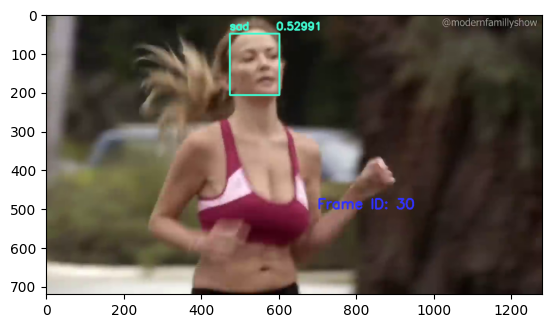

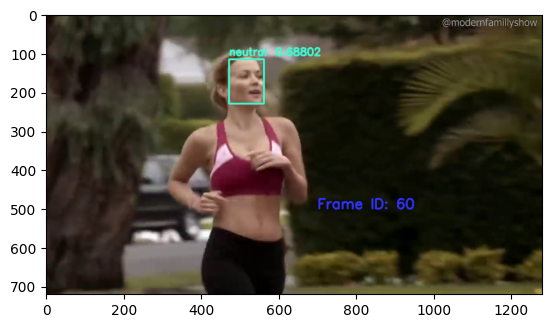

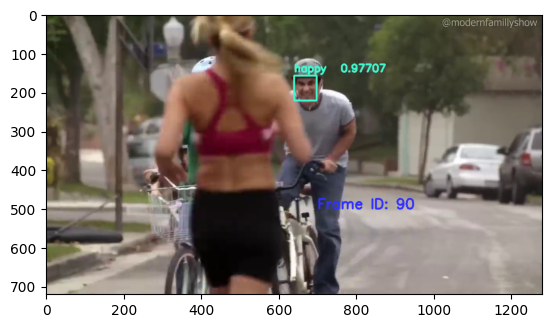

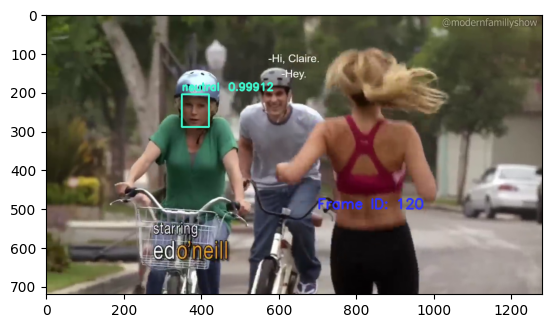

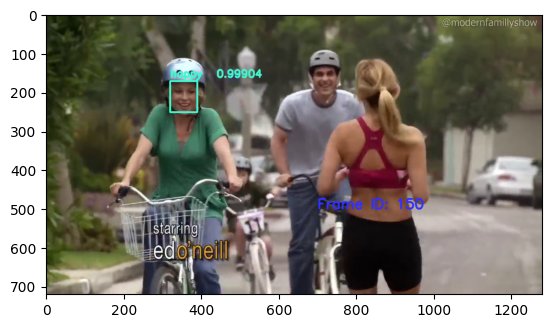

...

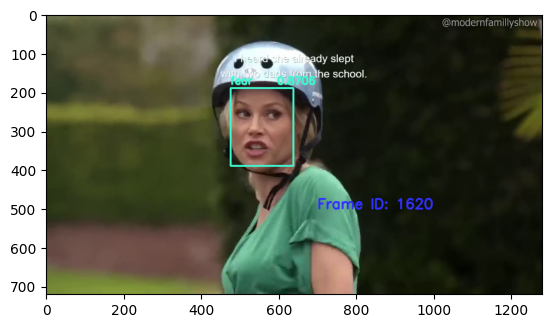

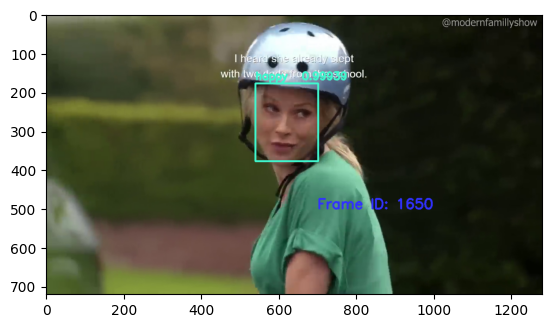

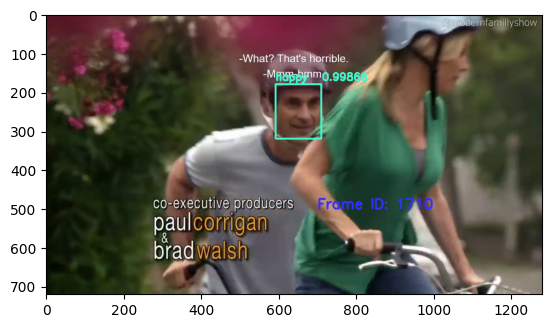

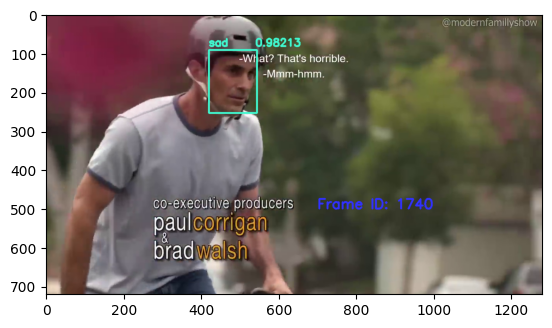

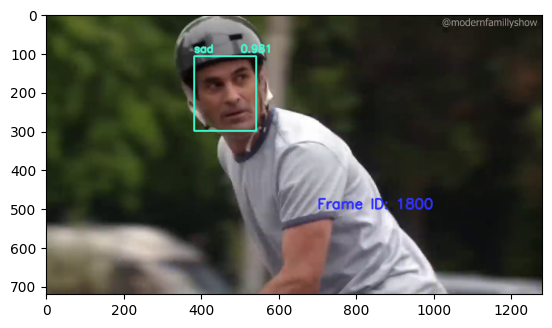

In [34]:
from ipywidgets import Video, Image
input_path = 'modern_family.mp4'
output_path = 'modern_family_output_cheap.mp4'

dataframe = response.as_df()
annotate_video(dataframe, input_path, output_path, table_name="emotion_result_cheap")

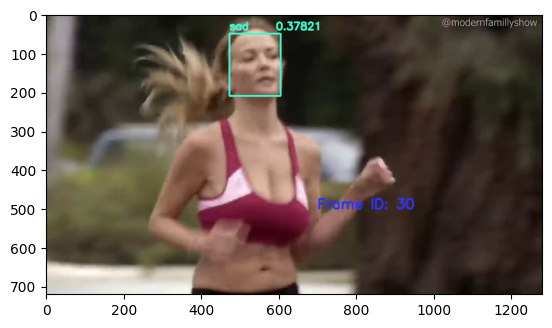

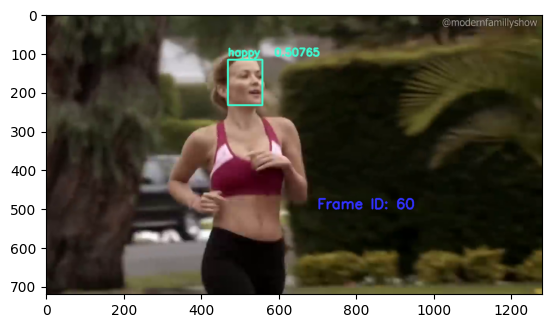

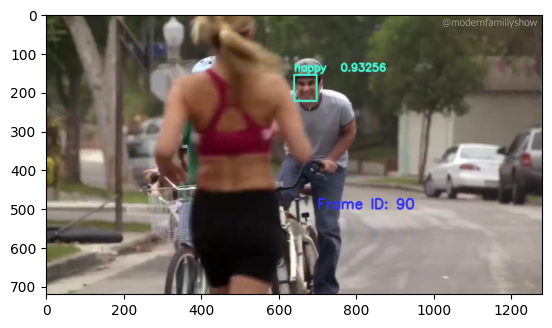

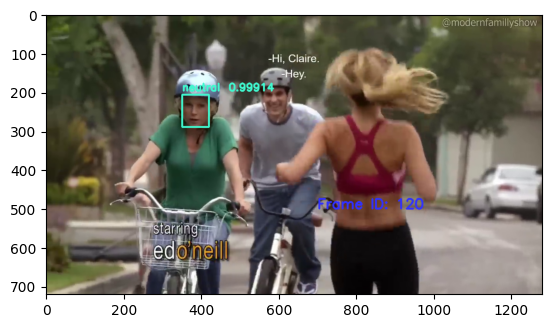

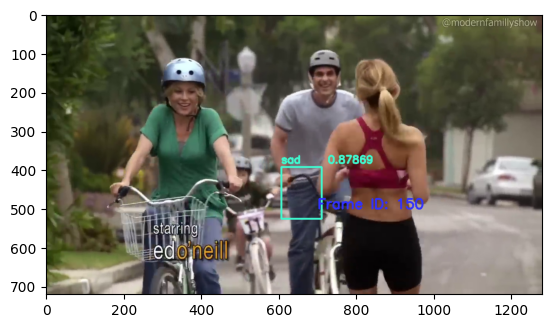

...

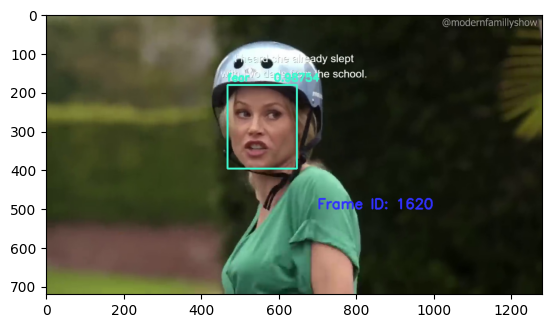

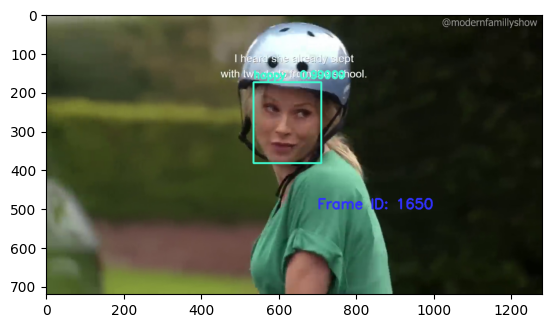

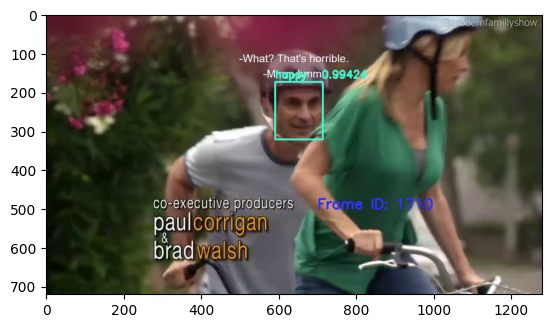

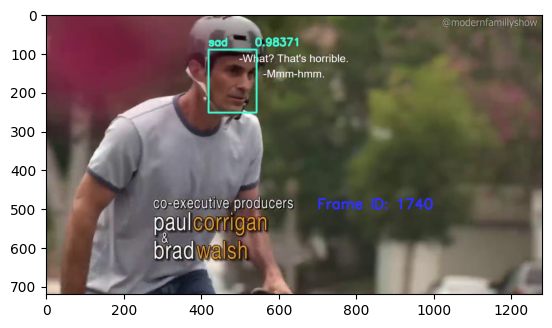

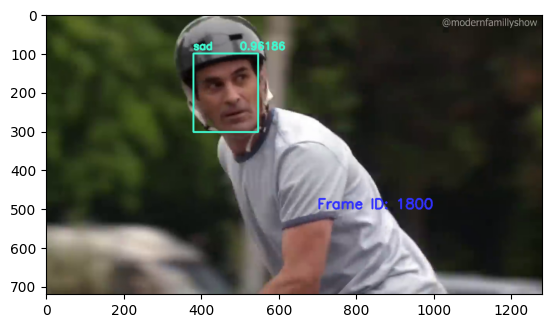

In [17]:
from ipywidgets import Video, Image
input_path = 'modern_family.mp4'
output_path = 'modern_family_output.mp4'

dataframe = response.as_df()
annotate_video(dataframe, input_path, output_path)


In [30]:
from IPython.display import Video
Video("modern_family_output.mp4", height=450, width=800, embed=True)

In [35]:
stop_eva_server()